# Plotly 한번에 제대로 배우기
From [Suanlab](https://www.youtube.com/watch?v=i-xbj0owgEE)

## Plotly 특징

* 인터랙티브 그래프 생성
* JSON 데이터 형식으로 저장
* 벡터 이미지, 래스터 이미지로 Export 가능

In [1]:
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.validators.scatter.marker import SymbolValidator

import pandas as pd
import numpy as np
from urllib.request import urlopen
import json

## Plotly 차트

### 히트맵(Heatmaps)

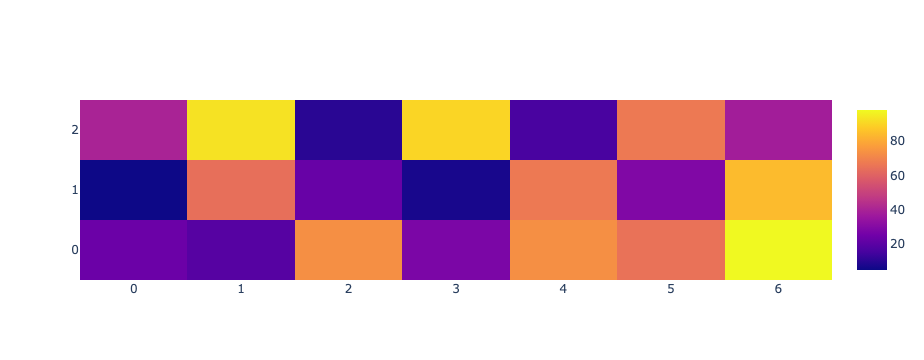

In [87]:
n = np.random.randint(1, 100, size=(3,7))
fig = go.Figure(data=go.Heatmap(z=n))
fig.show()


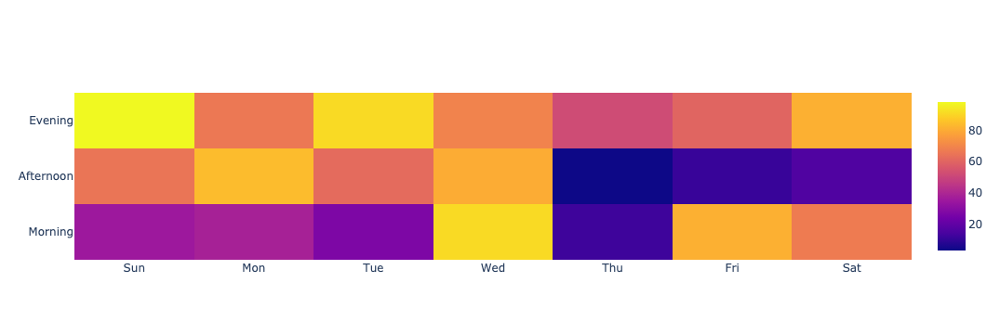

In [88]:
w = ['Sun', 'Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat']
t = ['Morning', 'Afternoon', 'Evening']
n = np.random.randint(1, 100, size=(3,7))
fig = go.Figure(data=go.Heatmap(x=w, y=t,z=n))
fig.show()

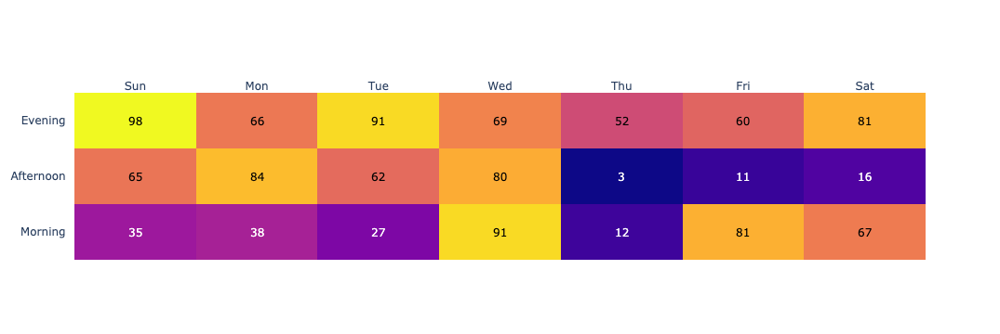

In [89]:
fig = ff.create_annotated_heatmap(x=w, y=t, z=n)
fig.show()

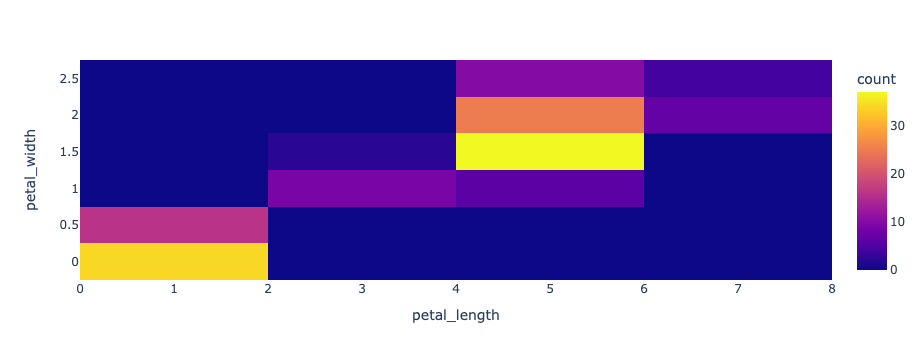

In [90]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width')
fig.show()

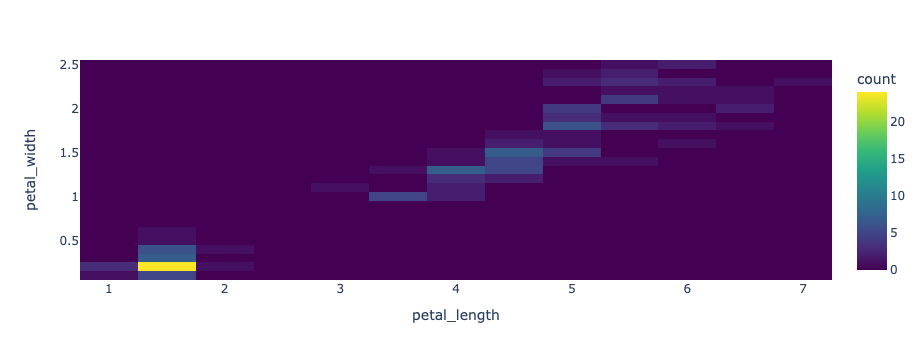

In [91]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width',
                        nbinsx=20, nbinsy=30,
                        color_continuous_scale='viridis')
fig.show()
#20개로 촘촘하게 

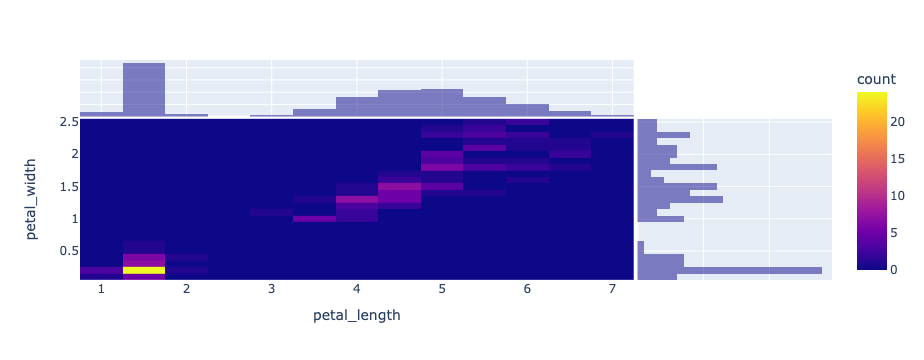

In [92]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width',
                        nbinsx=20, nbinsy=30,
                        marginal_x='histogram', marginal_y='histogram')
fig.show()
# heatmap 정보로 histogram 그리기

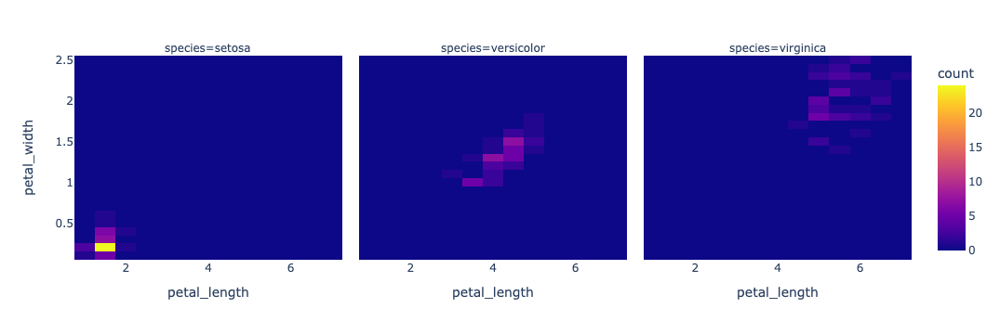

In [93]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width',
                        nbinsx=20, nbinsy=30,
                        facet_col='species')
fig.show()

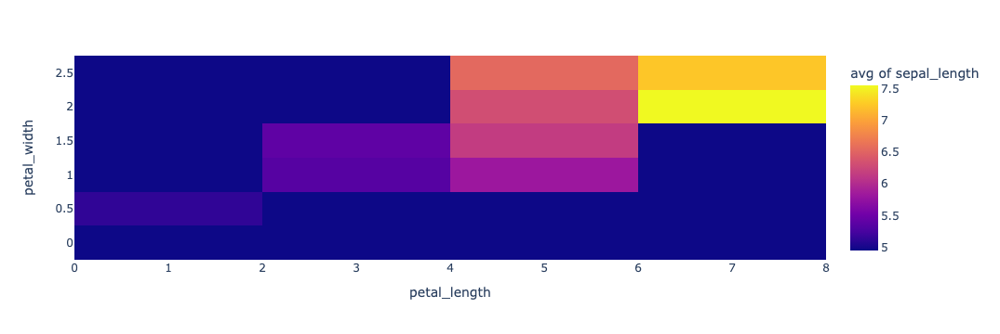

In [94]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width',
                        z='sepal_length', histfunc='avg')
fig.show()

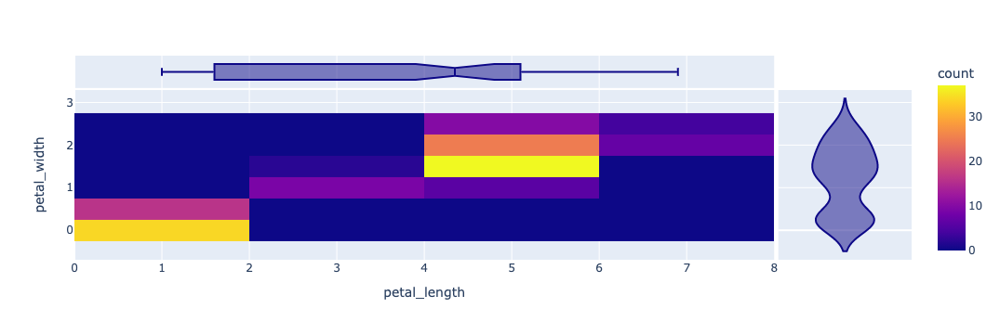

In [95]:
fig = px.density_heatmap(iris, x='petal_length', y='petal_width',
                        marginal_x='box', marginal_y='violin')
fig.show()

### 파이 차트(Pie Charts)

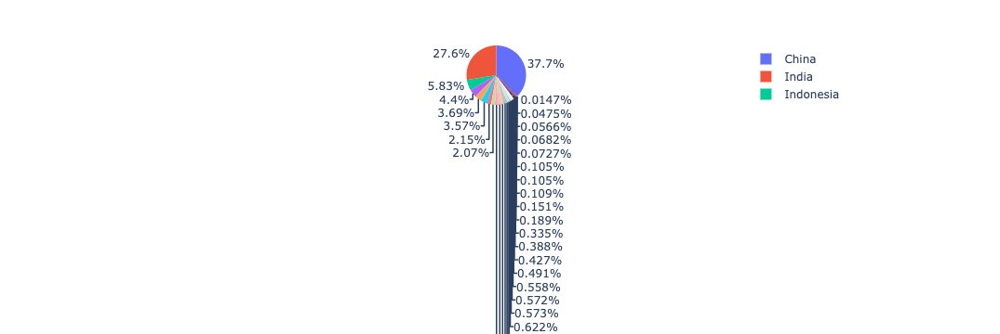

In [96]:
fig = px.pie(gapminder_asia, values='pop', names='country')
fig.show()

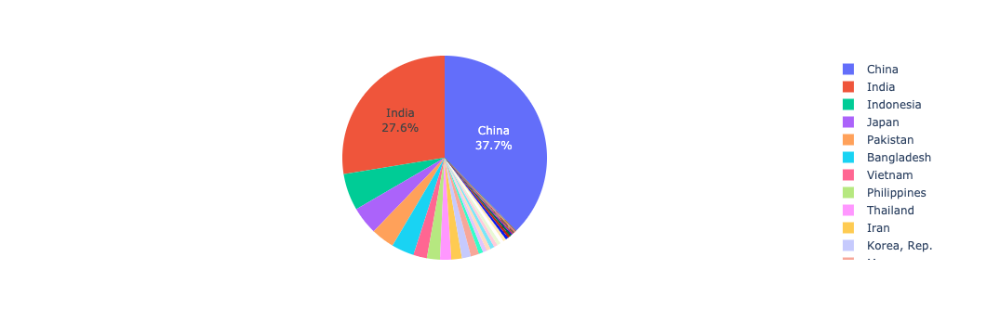

In [97]:
fig = px.pie(gapminder_asia, values='pop', names='country',
            hover_data=['lifeExp'],labels={'lifeExp':'life expectancy'})
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

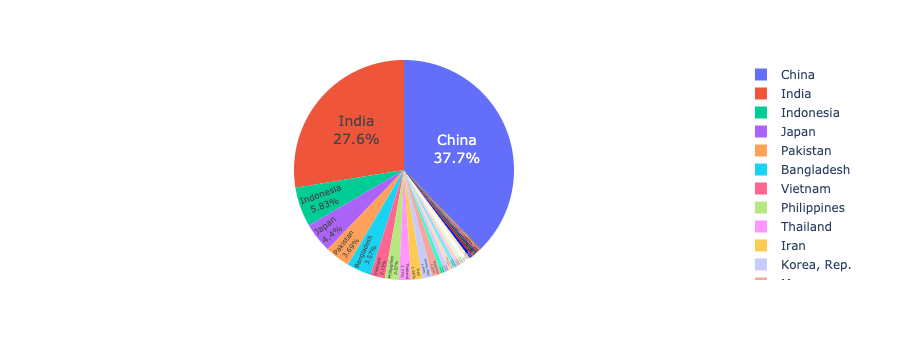

In [98]:
fig = px.pie(gapminder_asia, values='pop', names='country',
            hover_data=['lifeExp'],labels={'lifeExp':'life expectancy'})
fig.update_traces(textposition='inside', textinfo='percent+label', textfont_size=14)
fig.show()

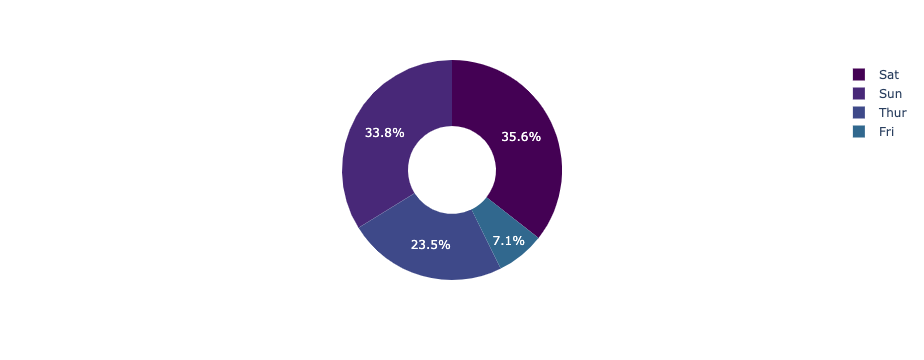

In [99]:
fig = px.pie(tips, values='tip', names='day', 
             color_discrete_sequence=px.colors.sequential.Viridis, hole=.4)
fig.show()

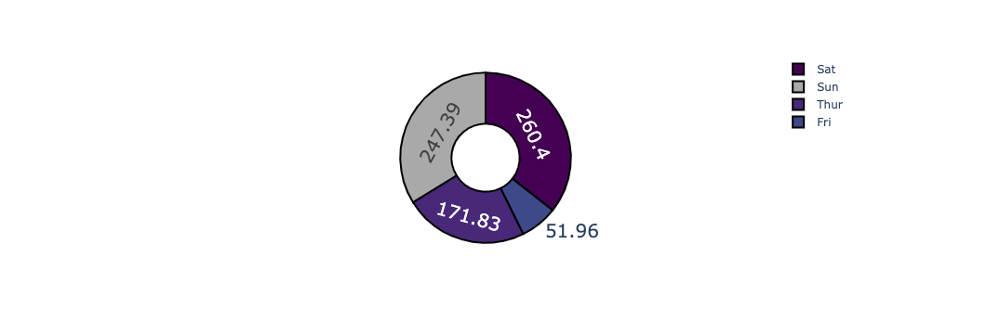

In [100]:
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='black', width=2)),
                  pull=[0, 0.2, 0, 0])
fig.show()

### Sunburst Chart

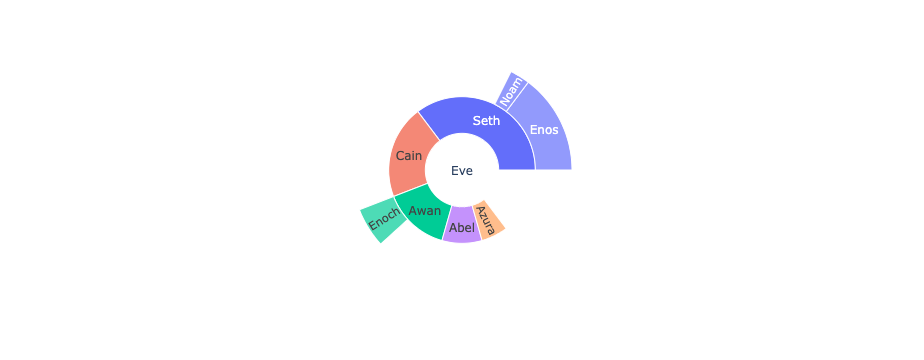

In [101]:
data = dict(character=['Eve', 'Cain', 'Seth', 'Enos', 'Noam', 'Abel', 'Awan', 'Enoch', 'Azura'],
            parent=['', 'Eve', 'Eve', 'Seth', 'Seth', 'Eve', 'Eve', 'Awan', 'Eve'],
            value=[10, 14, 12, 10 ,2, 6, 6, 4, 4,])
fig = px.sunburst(data, names='character', parents='parent', values='value')
fig.show()

### 폴라 차트(Polar Charts)

In [102]:
wind = px.data.wind()
wind

,direction,strength,frequency
0,N,0-1,0.5
1,NNE,0-1,0.6
2,NE,0-1,0.5
3,ENE,0-1,0.4
4,E,0-1,0.4
...,...,...,...
123,WSW,6+,0.1
124,W,6+,0.9
125,WNW,6+,2.2
126,NW,6+,1.5


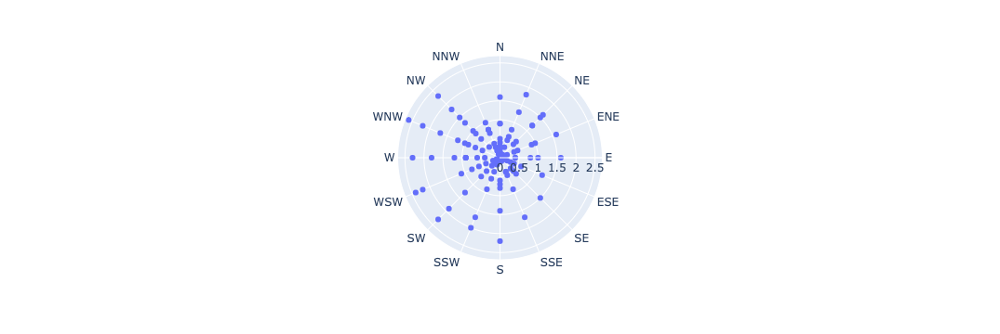

In [103]:
fig = px.scatter_polar(wind, r='frequency', theta='direction')
fig.show()

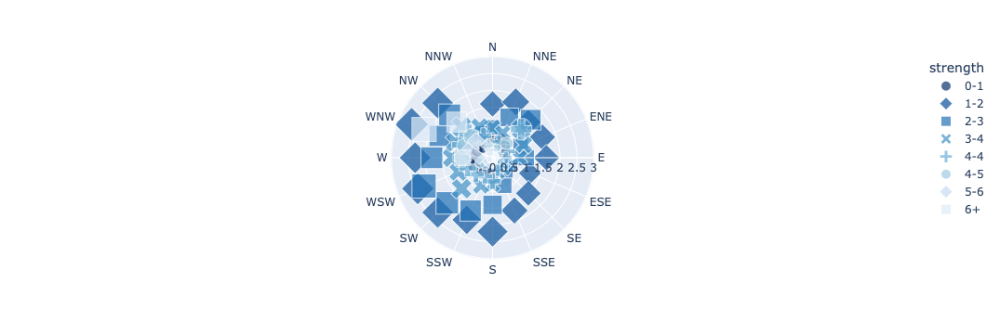

In [104]:
fig = px.scatter_polar(wind, r='frequency', theta='direction',
                      color='strength', symbol='strength', size='frequency',
                      color_discrete_sequence=px.colors.sequential.Blues_r)
fig.show()

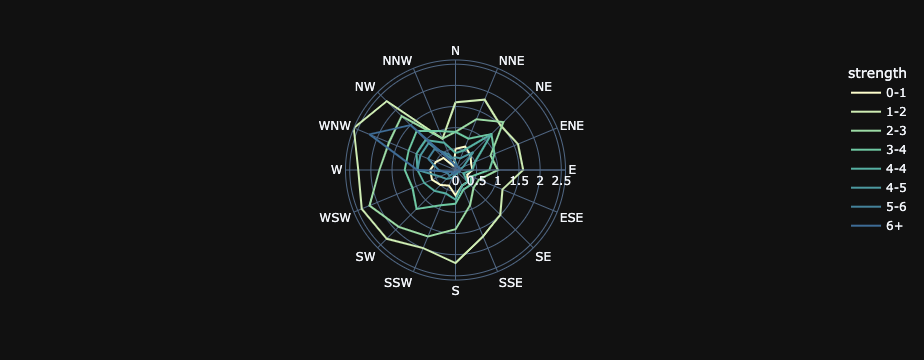

In [105]:
fig = px.line_polar(wind, r='frequency', theta='direction',
                      color='strength', line_close=True, template='plotly_dark',
                      color_discrete_sequence=px.colors.sequential.deep)
fig.show()

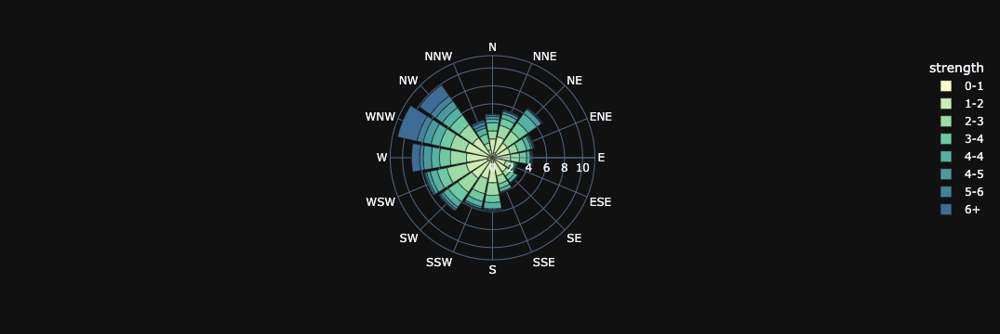

In [106]:
fig = px.bar_polar(wind, r='frequency', theta='direction',
                      color='strength', template='plotly_dark',
                      color_discrete_sequence=px.colors.sequential.deep)
fig.show()

### 병렬 다이어그램(Parallel Diagram)

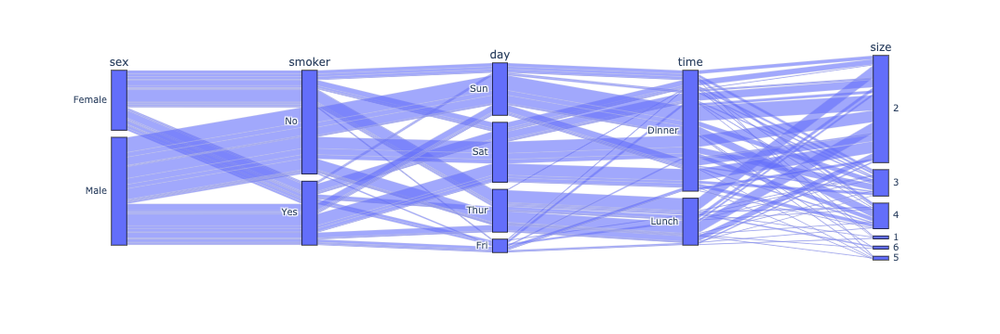

In [107]:
fig = px.parallel_categories(tips)
fig.show()

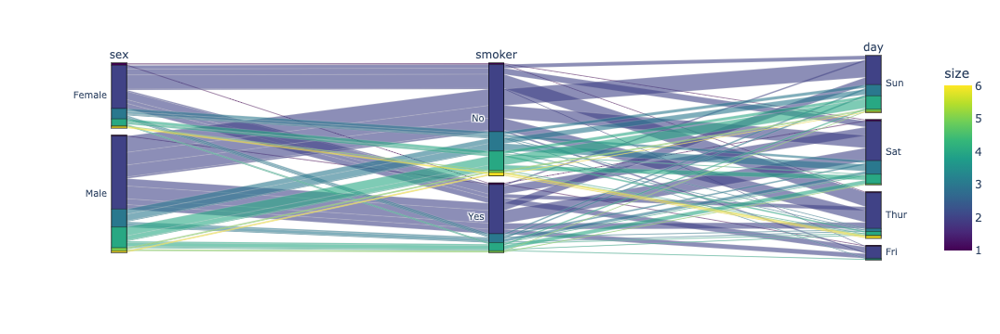

In [108]:
fig = px.parallel_categories(tips, dimensions=['sex','smoker','day'],
                             color='size',
                             color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

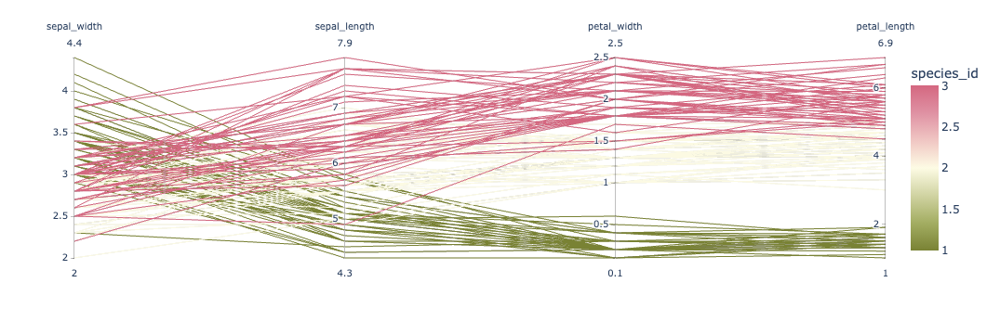

In [109]:
fig = px.parallel_coordinates(iris, color='species_id',
                              dimensions=['sepal_width', 'sepal_length',
                                          'petal_width', 'petal_length'],
                              color_continuous_scale=px.colors.diverging.Armyrose,
                              color_continuous_midpoint=2)
fig.show()

### 덴드로그램(Dendrograms)

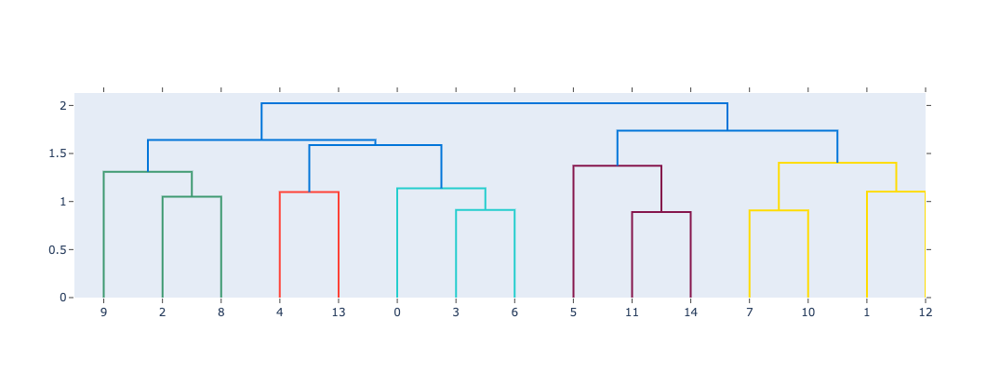

In [110]:
x = np.random.rand(15,12)
fig = ff.create_dendrogram(x)
fig.update_layout(width=800, height=400)
fig.show()

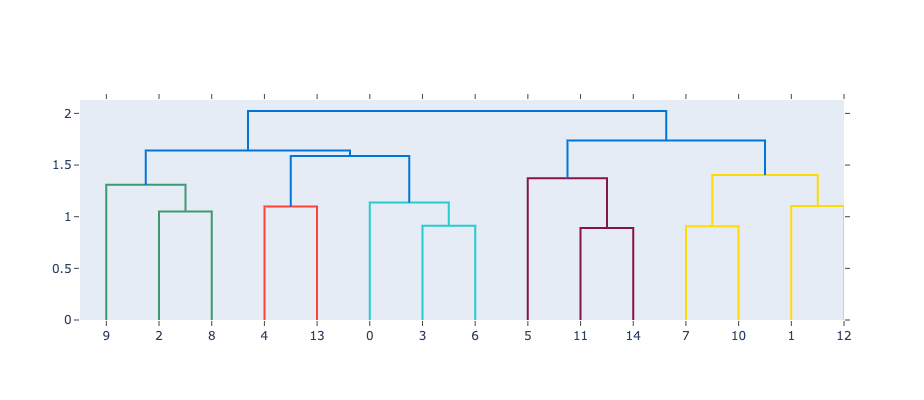

In [111]:
fig = ff.create_dendrogram(x, color_threshold=1.5)
fig.update_layout(width=800, height=400)
fig.show()

### 맵(Maps)

In [112]:
carshare = px.data.carshare()
carshare

,centroid_lat,centroid_lon,car_hours,peak_hour
0,45.471549,-73.588684,1772.750000,2
1,45.543865,-73.562456,986.333333,23
2,45.487640,-73.642767,354.750000,20
3,45.522870,-73.595677,560.166667,23
4,45.453971,-73.738946,2836.666667,19
...,...,...,...,...
244,45.547171,-73.556258,951.416667,3
245,45.546482,-73.574939,795.416667,2
246,45.495523,-73.627725,425.750000,8
247,45.521199,-73.581789,1044.833333,17


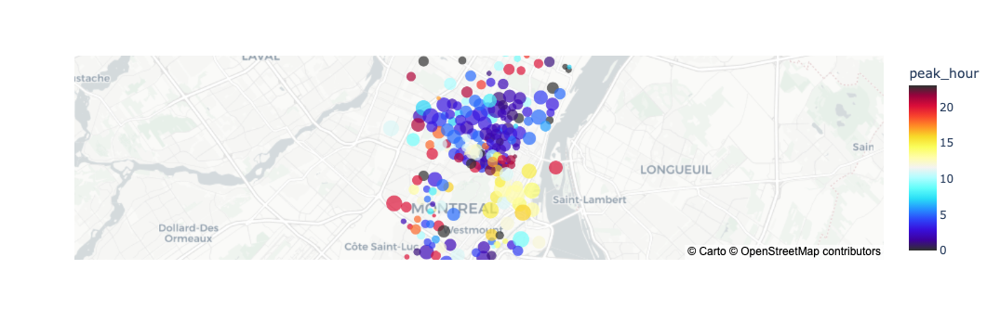

In [113]:
fig = px.scatter_mapbox(carshare, lat='centroid_lat', lon='centroid_lon', color='peak_hour',
                        size='car_hours', color_continuous_scale=px.colors.cyclical.Edge,
                        size_max=15, zoom=10, mapbox_style='carto-positron')
fig.show()

* https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json

In [114]:
response = urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json')

counties = json.load(response)

counties["features"][0]


{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

* https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv

In [115]:
unemp = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv", dtype={"fips":str})
unemp.head()
# unemployed 중 fips를 str로가져와야함 기본값은 숫자

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5


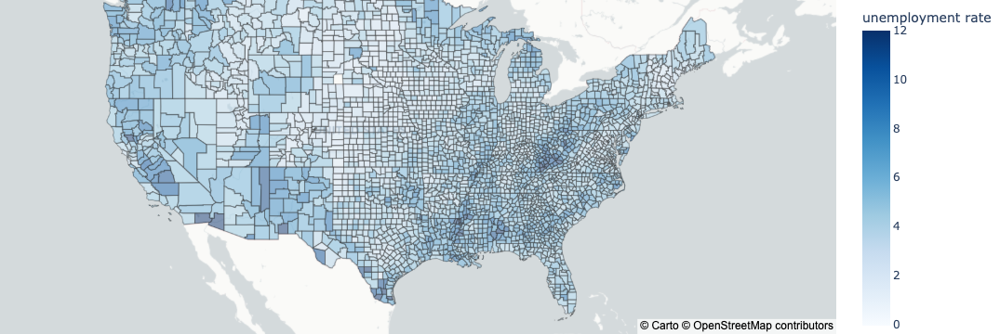

In [116]:
fig = px.choropleth_mapbox(unemp, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale='blues',
                           range_color=(0, 12),
                           mapbox_style='carto-positron',
                           zoom=3, center={'lat':37,'lon':-95},
                           opacity=0.5, labels={'unemp':"unemployment rate"})
fig.update_layout(margin={'r':0, 't':0, 'l':0,'b':0})
fig.show()

* https://raw.githubusercontent.com/plotly/datasets/master/us-cities-top-1k.csv

In [117]:
us_cities = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/us-cities-top-1k.csv')
us_cities = us_cities.query("State in ['California', 'New York']")
us_cities

,City,State,Population,lat,lon
1,Perris,California,72326,33.782519,-117.228648
11,Buena Park,California,82882,33.867514,-117.998118
19,Westminster,California,91739,33.751342,-117.993992
26,Rancho Palos Verdes,California,42448,33.744461,-118.387017
36,Buffalo,New York,258959,42.886447,-78.878369
...,...,...,...,...,...
981,Stanton,California,38623,33.802516,-117.993116
991,Santa Clara,California,120245,37.354108,-121.955236
992,Oceanside,California,172794,33.195870,-117.379483
993,Lake Forest,California,79312,33.646966,-117.689218


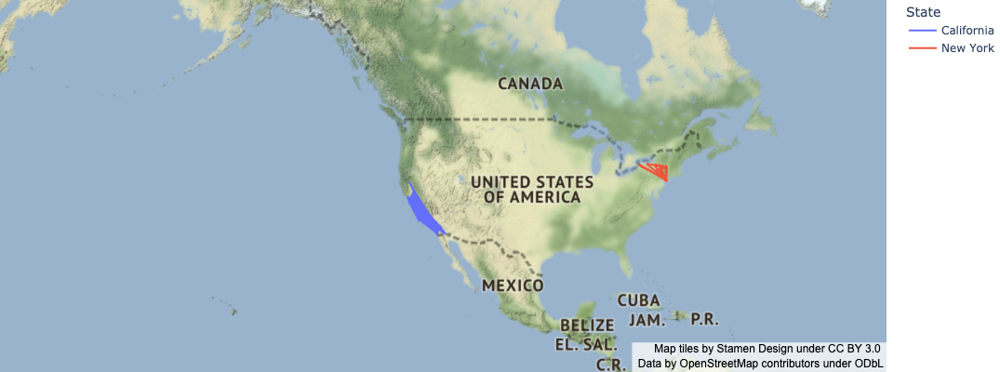

In [118]:
fig = px.line_mapbox(us_cities, lat="lat", lon='lon',
                     color='State', zoom=2, height=400)
fig.update_layout(mapbox_style='stamen-terrain',
                  mapbox_zoom=2, mapbox_center_lat=40,
                  margin={'r':0, 't':0, 'l':0,'b':0})
fig.show()

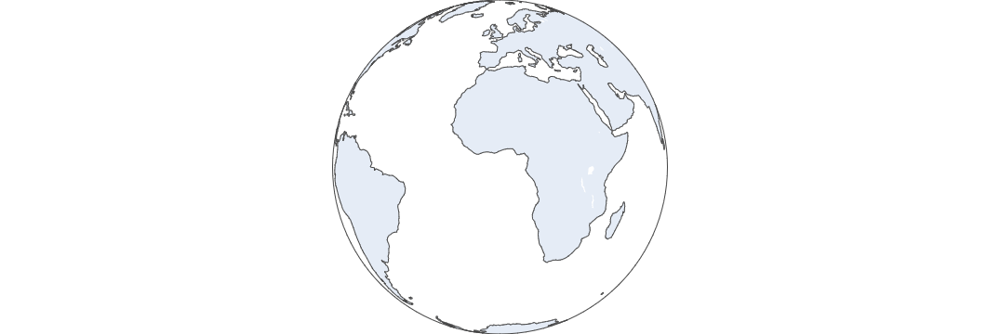

In [119]:
fig = go.Figure(go.Scattergeo())
fig.update_geos(projection_type='orthographic')
fig.update_layout(height=300, margin={'r':0, 't':0, 'l':0,'b':0})
fig.show()

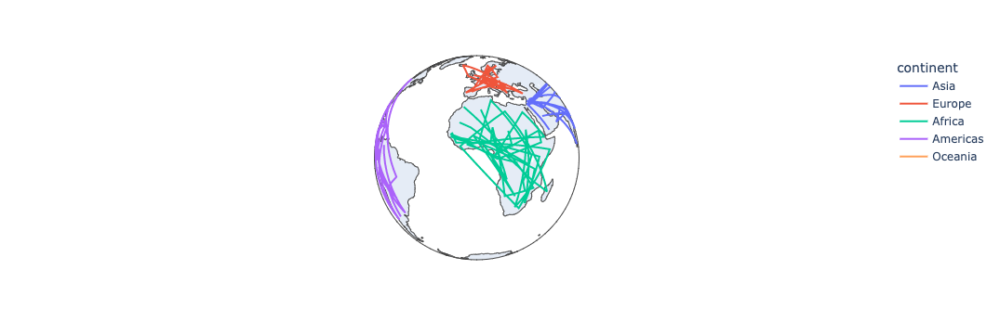

In [120]:
fig = px.line_geo(gapminder_2007, locations='iso_alpha', color='continent',
                  projection='orthographic')
fig.show()

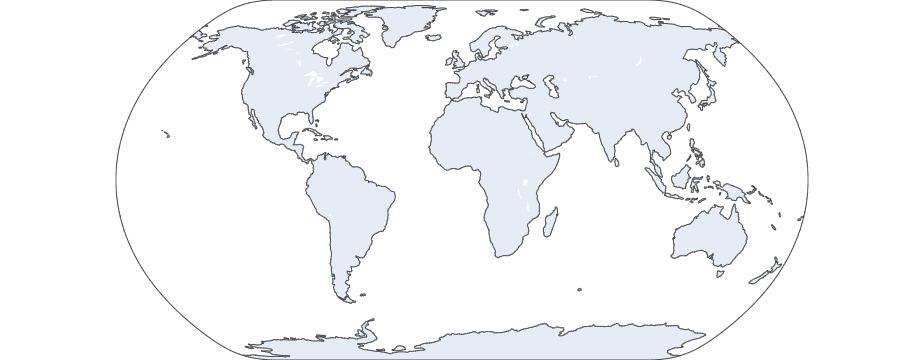

In [121]:
fig = go.Figure(go.Scattergeo())
fig.update_geos(projection_type='natural earth')
fig.update_layout(height=300, margin={'r':0, 't':0, 'l':0,'b':0})
fig.show()

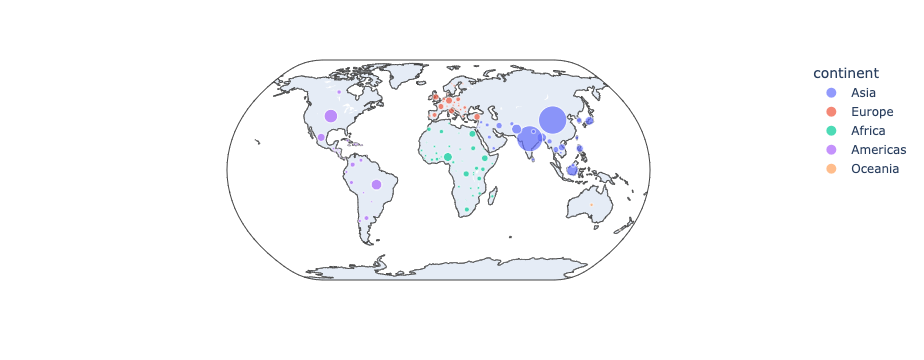

In [122]:
fig = px.scatter_geo(gapminder_2007, locations='iso_alpha', color='continent',
                  hover_name='country', size='pop', projection='natural earth')
fig.show()

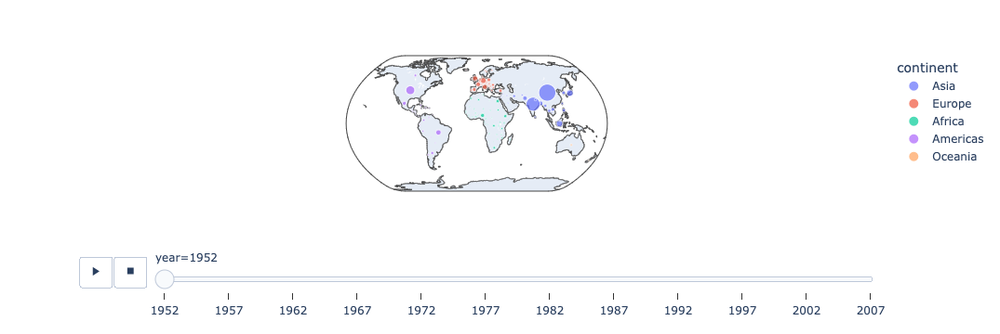

In [123]:
fig = px.scatter_geo(gapminder, locations='iso_alpha', color='continent',
                  hover_name='country', size='pop', projection='natural earth',
                    animation_frame='year')
fig.show()

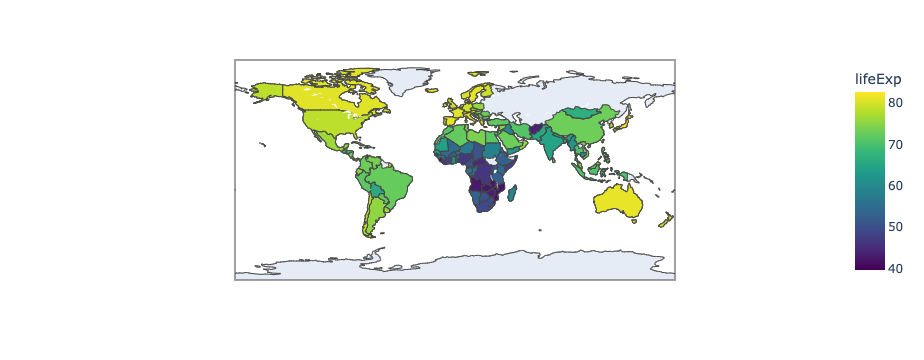

In [124]:
fig = px.choropleth(gapminder_2007, locations='iso_alpha',
                    color='lifeExp', hover_name='country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.show()


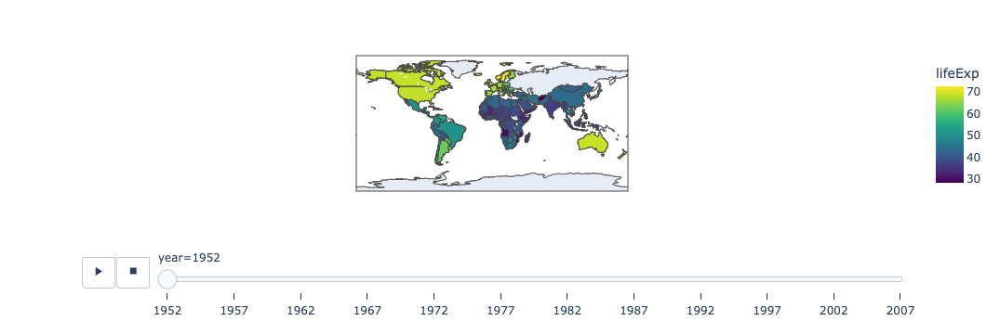

In [125]:
fig = px.choropleth(gapminder, locations='iso_alpha',
                    color='lifeExp', hover_name='country',
                    color_continuous_scale=px.colors.sequential.Viridis,
                   animation_frame='year')
fig.show()

* https://raw.githubusercontent.com/plotly/datasets/master/2014_world_gdp_with_codes.csv

In [126]:
gdp = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_world_gdp_with_codes.csv')
gdp

,COUNTRY,GDP (BILLIONS),CODE
0,Afghanistan,21.71,AFG
1,Albania,13.40,ALB
2,Algeria,227.80,DZA
3,American Samoa,0.75,ASM
4,Andorra,4.80,AND
...,...,...,...
217,Virgin Islands,5.08,VGB
218,West Bank,6.64,WBG
219,Yemen,45.45,YEM
220,Zambia,25.61,ZMB


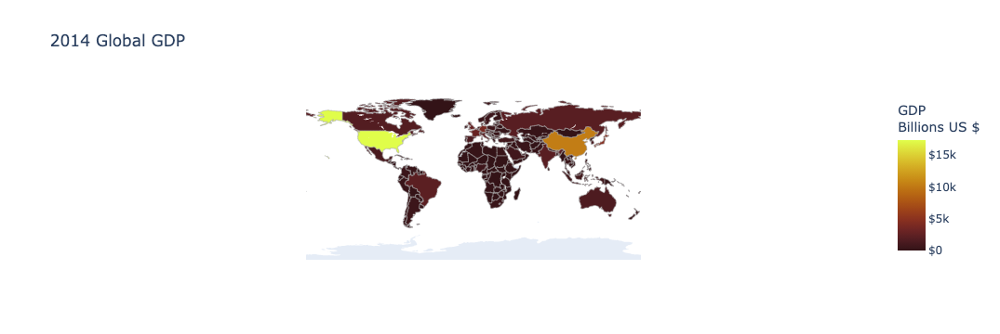

In [127]:
fig = go.Figure(data=go.Choropleth(locations= gdp['CODE'],
                                   z= gdp['GDP (BILLIONS)'],
                                   text = gdp['COUNTRY'],
                                   colorscale='solar_r',
                                   autocolorscale=False,
                                   reversescale=True,
                                   marker_line_color='darkgray',
                                   marker_line_width=0.5,
                                   colorbar_tickprefix='$',
                                   colorbar_title= 'GDP<br>Billions US $'))
fig.update_layout(title_text = '2014 Global GDP',
                  geo = dict(showframe=False, showcoastlines=False, 
                             projection_type='equirectangular'))
fig.show()
                                   

* https://raw.githubusercontent.com/plotly/datasets/master/earthquakes-23k.csv

In [128]:
earthquakes = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/earthquakes-23k.csv')
earthquakes

,Date,Latitude,Longitude,Magnitude
0,01/02/1965,19.2460,145.6160,6.0
1,01/04/1965,1.8630,127.3520,5.8
2,01/05/1965,-20.5790,-173.9720,6.2
3,01/08/1965,-59.0760,-23.5570,5.8
4,01/09/1965,11.9380,126.4270,5.8
...,...,...,...,...
23407,12/28/2016,38.3917,-118.8941,5.6
23408,12/28/2016,38.3777,-118.8957,5.5
23409,12/28/2016,36.9179,140.4262,5.9
23410,12/29/2016,-9.0283,118.6639,6.3


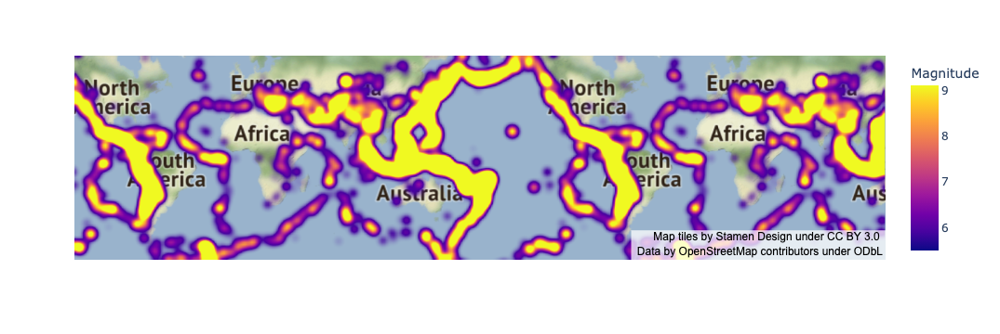

In [129]:
fig = px.density_mapbox(earthquakes, lat='Latitude', lon='Longitude', 
                        z='Magnitude', radius=10, center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style='stamen-terrain')
fig.show()

### 3D 차트(3D Charts)

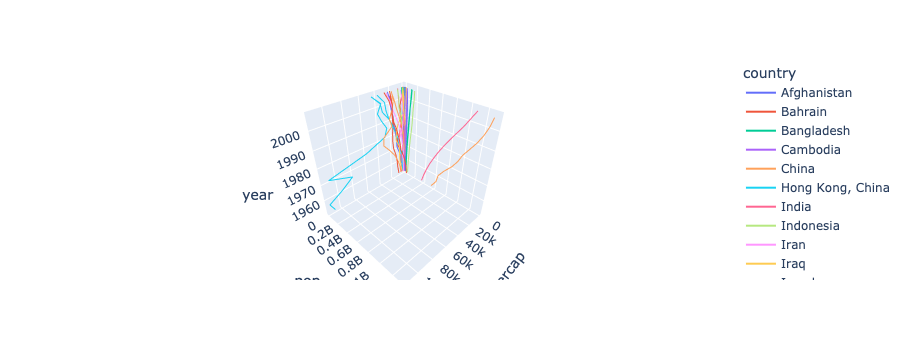

In [130]:
fig = px.line_3d(gapminder_asia, x='gdpPercap', y='pop', z='year', color='country')
fig.show()

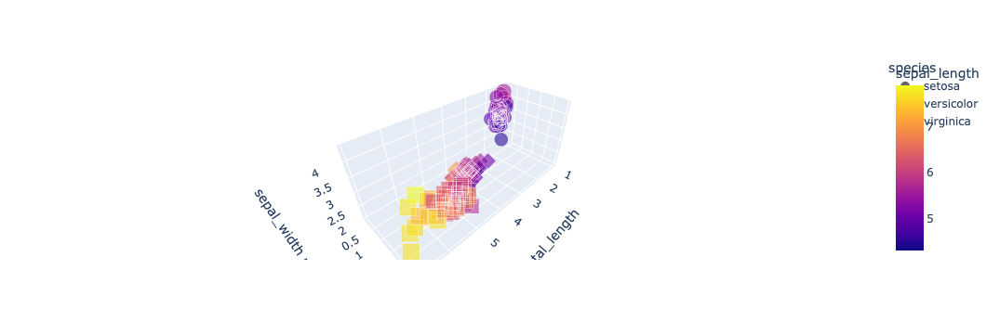

In [131]:
fig = px.scatter_3d(iris, x='petal_length', y='petal_width', z='sepal_width',
                    color='sepal_length', symbol='species',
                    size='sepal_length', opacity=0.6)
fig.show()
                    

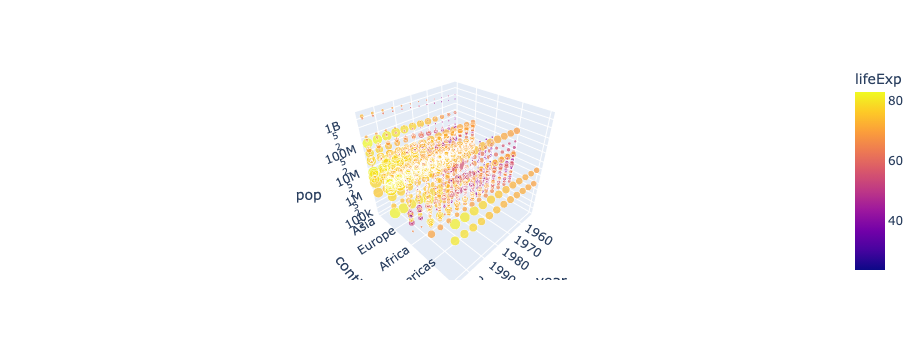

In [132]:
fig = px.scatter_3d(gapminder, x='year', y='continent', z='pop',
                    size='gdpPercap', color='lifeExp', 
                    hover_data=['country'])
fig.update_layout(scene_zaxis_type='log')
fig.show()

### 기타 차트

* 간트 차트(Gantt Charts): https://plotly.com/python/gantt/
* 테이블(Tables): https://plotly.com/python/table/
* 생키 다이어그램(Sankey Diagram): https://plotly.com/python/sankey-diagram/
* 트리맵(Treemap): https://plotly.com/python/treemaps/
* 트리플롯(Tree-plots): https://plotly.com/python/tree-plots/
* 3차 플롯(Ternary Plots): https://plotly.com/python/ternary-plots/
* 3차 오버레이(Ternary Overlay): https://plotly.com/python/ternary-scatter-contour/
* 3차 등고선(Ternary Contours): https://plotly.com/python/ternary-contour/
* 이미지쇼(Image Show): https://plotly.com/python/imshow/
* Quiver Plots: https://plotly.com/python/quiver-plots/
* 스트림라인 플롯(Streamline Plots): https://plotly.com/python/streamline-plots/
* 카펫 플롯(Carpet Plots): https://plotly.com/python/carpet-plot/
* 카펫 등고선(Carpet Contour Plot): https://plotly.com/python/carpet-contour/
* 카펫 산점도(Carpet Scatter Plot): https://plotly.com/python/carpet-scatter/
* 네트워크 그래프(Network Graphs): https://plotly.com/python/network-graphs/
* 깔대기 차트(Funnel Chart): https://plotly.com/python/funnel-charts/
* 등고선 플롯(Contour Plot): https://plotly.com/python/contour-plots/
* 2D 히스토그램 등고선(2D Histogram Contour): https://plotly.com/python/2d-histogram-contour/
* Trisurf Plots: https://plotly.com/python/trisurf/
* 3D Mesh Plots: https://plotly.com/python/3d-mesh/
* 3D Isosurface Plots: https://plotly.com/python/3d-isosurface-plots/
* 3D Volume Plots: https://plotly.com/python/3d-volume-plots/
* 3D Cone Plots: https://plotly.com/python/cone-plot/
* 3D Streamtube Plots: https://plotly.com/python/streamtube-plot/
* 3D Camera Controls: https://plotly.com/python/3d-camera-controls/



---

